In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from statsmodels.tsa.stattools import adfuller
import seaborn as sns
df = pd.read_csv(r"C:\Users\aamir\Aamir_BU\OneDrive - BENNETT UNIVERSITY\CSET 369 - Time Series Analysis\Project\AEP_hourly.csv")
df

,Datetime,AEP_MW
0,2004-12-31 01:00:00,13478.0
1,2004-12-31 02:00:00,12865.0
2,2004-12-31 03:00:00,12577.0
3,2004-12-31 04:00:00,12517.0
4,2004-12-31 05:00:00,12670.0
...,...,...
121268,2018-01-01 20:00:00,21089.0
121269,2018-01-01 21:00:00,20999.0
121270,2018-01-01 22:00:00,20820.0
121271,2018-01-01 23:00:00,20415.0


In [3]:
# Convert Datetime column
df['Datetime'] = pd.to_datetime(df['Datetime'])
df.set_index('Datetime', inplace=True)

# Display basic info
print(df.info())
print(df.describe())

# Check for missing values
print(df.isnull().sum())

# Plot Time Series
fig = px.line(df, x=df.index, y="AEP_MW", title="AEP Power Consumption Over Time")
fig.show()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 121273 entries, 2004-12-31 01:00:00 to 2018-01-02 00:00:00
Data columns (total 1 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   AEP_MW  121273 non-null  float64
dtypes: float64(1)
memory usage: 1.9 MB
None
              AEP_MW
count  121273.000000
mean    15499.513717
std      2591.399065
min      9581.000000
25%     13630.000000
50%     15310.000000
75%     17200.000000
max     25695.000000
AEP_MW    0
dtype: int64


In [4]:
from statsmodels.tsa.stattools import adfuller, kpss

def check_stationarity(series):
    print("\n===== Augmented Dickey-Fuller Test (ADF) =====")
    adf_result = adfuller(series)
    print(f"ADF Statistic: {adf_result[0]}")
    print(f"p-value: {adf_result[1]}")
    print(f"Critical Values: {adf_result[4]}")
    if adf_result[1] <= 0.05:
        print("Conclusion: The series is Stationary (Reject H0).")
    else:
        print("Conclusion: The series is Non-Stationary (Fail to Reject H0).")

    print("\n===== Kwiatkowski-Phillips-Schmidt-Shin (KPSS) Test =====")
    kpss_result, kpss_pval, _, kpss_crit = kpss(series, regression='c', nlags="auto")
    print(f"KPSS Statistic: {kpss_result}")
    print(f"p-value: {kpss_pval}")
    print(f"Critical Values: {kpss_crit}")
    if kpss_pval <= 0.05:
        print("Conclusion: The series is Non-Stationary (Reject H0).")
    else:
        print("Conclusion: The series is Stationary (Fail to Reject H0).")

check_stationarity(df['AEP_MW'])


===== Augmented Dickey-Fuller Test (ADF) =====
ADF Statistic: -16.446812104686842
p-value: 2.3990113240015636e-29
Critical Values: {'1%': -3.430403955318047, '5%': -2.8615638474512295, '10%': -2.566782693155802}
Conclusion: The series is Stationary (Reject H0).

===== Kwiatkowski-Phillips-Schmidt-Shin (KPSS) Test =====
KPSS Statistic: 5.979460043621711
p-value: 0.01
Critical Values: {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
Conclusion: The series is Non-Stationary (Reject H0).


C:\Users\aamir\anaconda3\Lib\site-packages\statsmodels\tsa\stattools.py:2018: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.




In [5]:
# Check for duplicate timestamps
duplicates = df.index.duplicated().sum()
print(f"Number of duplicate timestamps: {duplicates}")

if duplicates > 0:
    # Option 1: Keep the first occurrence (Drop Duplicates)
    df = df[~df.index.duplicated(keep='first')]
    
    # Option 2: Aggregate duplicates by averaging
    # df = df.groupby(df.index).mean()

# Apply First-Order Differencing
df['AEP_MW_diff'] = df['AEP_MW'].diff()

# Drop NaN values after differencing
df = df.dropna()

# Re-run stationarity tests
check_stationarity(df['AEP_MW_diff'])

Number of duplicate timestamps: 4

===== Augmented Dickey-Fuller Test (ADF) =====


C:\Users\aamir\AppData\Local\Temp\ipykernel_11800\2511450131.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



ADF Statistic: -45.02591732628695
p-value: 0.0
Critical Values: {'1%': -3.430403957544047, '5%': -2.8615638484350794, '10%': -2.5667826936794724}
Conclusion: The series is Stationary (Reject H0).

===== Kwiatkowski-Phillips-Schmidt-Shin (KPSS) Test =====
KPSS Statistic: 0.012463330960147267
p-value: 0.1
Critical Values: {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
Conclusion: The series is Stationary (Fail to Reject H0).


C:\Users\aamir\anaconda3\Lib\site-packages\statsmodels\tsa\stattools.py:2022: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.




In [6]:
import plotly.graph_objects as go

# Create figure
fig = go.Figure()

# Plot Original Series
fig.add_trace(go.Scatter(x=df.index, y=df['AEP_MW'], 
                         mode='lines', name='Original Series', 
                         line=dict(color='blue')))

# Plot First-Order Differenced Series
fig.add_trace(go.Scatter(x=df.index, y=df['AEP_MW_diff'], 
                         mode='lines', name='First-Order Differenced', 
                         line=dict(color='red', dash='dot')))

# Update layout
fig.update_layout(title="Original vs Differenced AEP_MW Time Series",
                  xaxis_title="Datetime",
                  yaxis_title="AEP_MW",
                  template="plotly_dark",
                  legend=dict(x=0.02, y=0.98))

fig.show()

In [7]:
df['hour'] = df.index.hour
df['dayofweek'] = df.index.dayofweek
df['month'] = df.index.month
df['year'] = df.index.year
df['quarter'] = df.index.quarter


In [8]:
from sklearn.model_selection import train_test_split

# Split data (80% Training, 20% Testing)
train_size = int(len(df) * 0.8)

train, test = df.iloc[:train_size], df.iloc[train_size:]

print(f"Training Set Size: {len(train)}")
print(f"Testing Set Size: {len(test)}")


Training Set Size: 97014
Testing Set Size: 24254


C:\Users\aamir\anaconda3\Lib\site-packages\statsmodels\graphics\tsaplots.py:348: FutureWarning:

The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.



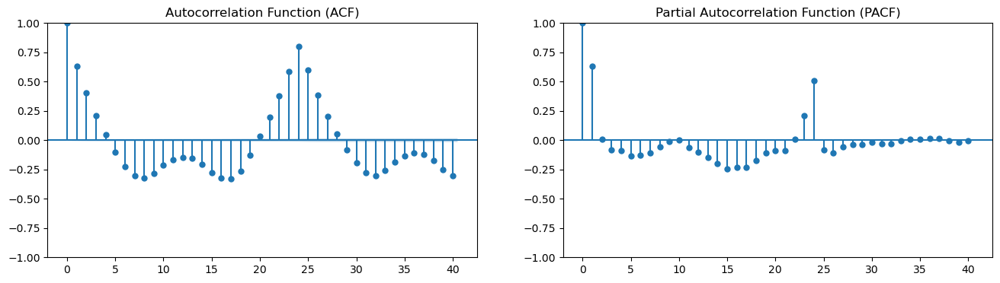

In [9]:
import statsmodels.api as sm
import matplotlib.pyplot as plt

fig, axes = plt.subplots(1, 2, figsize=(16, 4))

# ACF Plot (for MA order `q`)
sm.graphics.tsa.plot_acf(df['AEP_MW_diff'].dropna(), lags=40, ax=axes[0])
axes[0].set_title("Autocorrelation Function (ACF)")

# PACF Plot (for AR order `p`)
sm.graphics.tsa.plot_pacf(df['AEP_MW_diff'].dropna(), lags=40, ax=axes[1])
axes[1].set_title("Partial Autocorrelation Function (PACF)")

plt.show()


In [10]:
# ARIMA 
from statsmodels.tsa.arima.model import ARIMA

# Define ARIMA Model (using p=1, d=1, q=1 as an example)
model = ARIMA(train['AEP_MW'], order=(1, 1, 1))  
model_fit = model.fit()

# Print model summary
print(model_fit.summary())

C:\Users\aamir\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

C:\Users\aamir\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

A date index has been provided, but it is not monotonic and so will be ignored when e.g. forecasting.

C:\Users\aamir\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

C:\Users\aamir\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

A date index has been provided, but it is not monotonic and so will be ignored when e.g. forecasting.

C:\Users\aamir\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

A date index has been provided, but it has no associated 

                               SARIMAX Results                                
Dep. Variable:                 AEP_MW   No. Observations:                97014
Model:                 ARIMA(1, 1, 1)   Log Likelihood             -739939.429
Date:                Mon, 03 Mar 2025   AIC                        1479884.858
Time:                        19:48:14   BIC                        1479913.306
Sample:                             0   HQIC                       1479893.503
                              - 97014                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6305      0.003    202.632      0.000       0.624       0.637
ma.L1          0.0054      0.003      1.590      0.112      -0.001       0.012
sigma2      2.468e+05    398.757    618.960      0.0

In [11]:
import numpy as np
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Forecast future values
forecast = model_fit.forecast(steps=len(test))

# Calculate evaluation metrics
mae = mean_absolute_error(test['AEP_MW'], forecast)
rmse = np.sqrt(mean_squared_error(test['AEP_MW'], forecast))

print(f"Mean Absolute Error (MAE): {mae}")
print(f"Root Mean Squared Error (RMSE): {rmse}")


C:\Users\aamir\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: ValueWarning:

No supported index is available. Prediction results will be given with an integer index beginning at `start`.



Mean Absolute Error (MAE): 4244.42067033026
Root Mean Squared Error (RMSE): 4805.550020557019


In [12]:
import plotly.graph_objects as go

fig = go.Figure()

# Actual Values
fig.add_trace(go.Scatter(x=test.index, y=test['AEP_MW'], mode='lines', name='Actual', line=dict(color='blue')))

# Forecasted Values
fig.add_trace(go.Scatter(x=test.index, y=forecast, mode='lines', name='Forecasted', line=dict(color='red', dash='dot')))

# Update layout
fig.update_layout(title="ARIMA Model: Actual vs Forecasted",
                  xaxis_title="Datetime",
                  yaxis_title="AEP_MW",
                  template="plotly_dark")

fig.show()


In [13]:
# SARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

# Define and train the SARIMA model
sarima_model = SARIMAX(train['AEP_MW'], 
                       order=(1, 1, 1), 
                       seasonal_order=(1, 1, 1, 24), 
                       simple_differencing=True, 
                       low_memory=True)

sarima_fit = sarima_model.fit(disp=False)

# Forecast using SARIMA
sarima_forecast = sarima_fit.forecast(steps=len(test))

# Evaluate performance
mae_sarima = mean_absolute_error(test['AEP_MW'], sarima_forecast)
rmse_sarima = np.sqrt(mean_squared_error(test['AEP_MW'], sarima_forecast))

print(f"✅ SARIMA Model - MAE: {mae_sarima:.4f}, RMSE: {rmse_sarima:.4f}")


C:\Users\aamir\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

C:\Users\aamir\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

A date index has been provided, but it is not monotonic and so will be ignored when e.g. forecasting.

C:\Users\aamir\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

C:\Users\aamir\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

A date index has been provided, but it is not monotonic and so will be ignored when e.g. forecasting.

C:\Users\aamir\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: ValueWarning:

No supported index is available. Prediction results will 

✅ SARIMA Model - MAE: 14978.5141, RMSE: 15196.9409


In [14]:
import plotly.graph_objects as go
import pandas as pd

# Convert SARIMA forecast to a pandas Series with the correct index
sarima_forecast_series = pd.Series(sarima_forecast, index=test.index)

# Create the plot
fig = go.Figure()

# Plot Actual Data (Filled Area)
fig.add_trace(go.Scatter(
    x=test.index, 
    y=test['AEP_MW'], 
    mode='lines', 
    name='Actual AEP_MW',
    line=dict(color='blue'),
    fill='tozeroy',  # Fills the area below the line
    opacity=0.5
))

# Plot SARIMA Predictions (Dashed Line)
fig.add_trace(go.Scatter(
    x=test.index, 
    y=sarima_forecast_series, 
    mode='lines', 
    name='SARIMA Forecast',
    line=dict(color='red', dash='dot')
))

# Layout settings
fig.update_layout(
    title='SARIMA Model - Actual vs Predicted (Area Chart)',
    xaxis_title='Time',
    yaxis_title='AEP_MW',
    legend=dict(x=0, y=1),
    template='plotly_white'
)

# Show plot
fig.show()


In [15]:
# LSTM
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

# Reshape data for LSTM
train_lstm = train['AEP_MW'].values.reshape(-1, 1)
test_lstm = test['AEP_MW'].values.reshape(-1, 1)

# Build LSTM Model
model = Sequential([
    LSTM(50, return_sequences=True, input_shape=(train_lstm.shape[1], 1)),
    LSTM(50, return_sequences=False),
    Dense(25),
    Dense(1)
])

# Compile and Train
model.compile(optimizer='adam', loss='mse')
model.fit(train_lstm, train['AEP_MW'], epochs=20, batch_size=16, verbose=1)

# Predict
lstm_forecast = model.predict(test_lstm)

Epoch 1/20
6064/6064 [==============================] - 26s 4ms/step - loss: 65507940.0000
Epoch 2/20
6064/6064 [==============================] - 27s 5ms/step - loss: 6663758.0000
Epoch 3/20
6064/6064 [==============================] - 21s 3ms/step - loss: 6663538.0000
Epoch 4/20
6064/6064 [==============================] - 21s 3ms/step - loss: 6662965.0000
Epoch 5/20
6064/6064 [==============================] - 21s 3ms/step - loss: 6663875.0000
Epoch 6/20
6064/6064 [==============================] - 22s 4ms/step - loss: 6663574.5000
Epoch 7/20
6064/6064 [==============================] - 21s 3ms/step - loss: 6664146.0000
Epoch 8/20
6064/6064 [==============================] - 23s 4ms/step - loss: 6663788.0000
Epoch 9/20
6064/6064 [==============================] - 25s 4ms/step - loss: 6663717.5000
Epoch 10/20
6064/6064 [==============================] - 23s 4ms/step - loss: 6663986.0000
Epoch 11/20
6064/6064 [==============================] - 24s 4ms/step - loss: 6663680.5000
Epoch 1

In [16]:
import plotly.graph_objects as go
import numpy as np

# Create a time index for test data
time_index = test.index

# Convert predictions to a series for visualization
lstm_forecast_series = pd.Series(lstm_forecast.flatten(), index=time_index)

# Create the plot
fig = go.Figure()

# Plot Actual Data
fig.add_trace(go.Scatter(
    x=time_index, 
    y=test['AEP_MW'], 
    mode='lines', 
    name='Actual AEP_MW',
    line=dict(color='blue')
))

# Plot LSTM Predictions
fig.add_trace(go.Scatter(
    x=time_index, 
    y=lstm_forecast_series, 
    mode='lines', 
    name='LSTM Forecast',
    line=dict(color='red', dash='dot')
))

# Layout settings
fig.update_layout(
    title='LSTM Model - Actual vs Predicted',
    xaxis_title='Time',
    yaxis_title='AEP_MW',
    legend=dict(x=0, y=1),
    template='plotly_dark'
)

# Show plot
fig.show()

In [17]:
pip install prophet

Note: you may need to restart the kernel to use updated packages.Requirement already satisfied: prophet in c:\users\aamir\anaconda3\lib\site-packages (1.1.6)



19:58:56 - cmdstanpy - INFO - Chain [1] start processing
20:01:21 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\aamir\AppData\Local\Temp\ipykernel_11800\1279136532.py:24: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



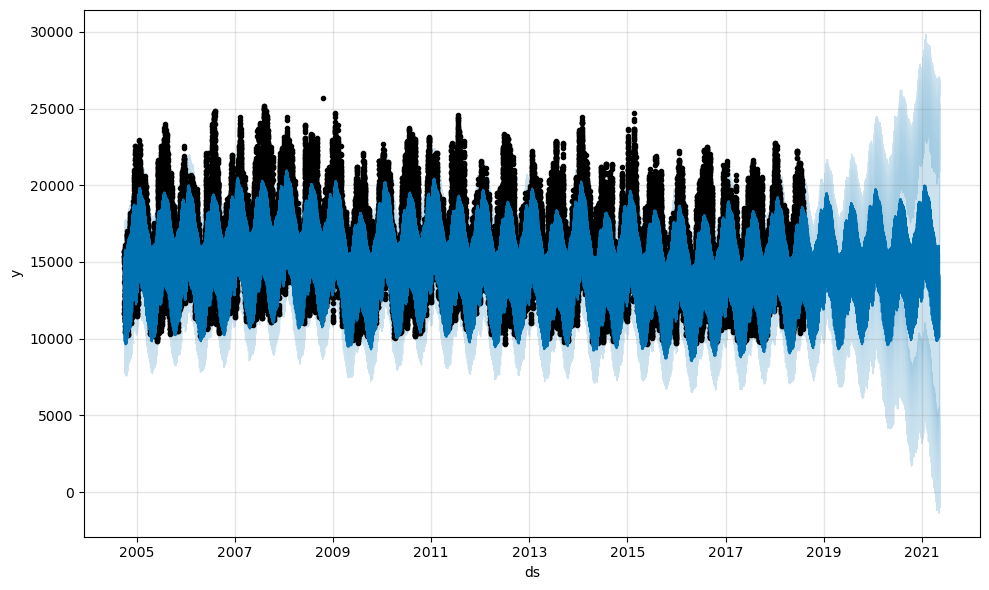

In [18]:
# PROPHET
from prophet import Prophet
import pandas as pd

# Prepare Data for Prophet
prophet_df = df[['AEP_MW']].copy()
prophet_df = prophet_df.reset_index().rename(columns={'Datetime': 'ds', 'AEP_MW': 'y'})

# Train Prophet Model
prophet = Prophet()
prophet.fit(prophet_df)

# Create Future DataFrame for forecasting
future = prophet.make_future_dataframe(periods=len(test), freq='H')

# Forecast
prophet_forecast = prophet.predict(future)

# Extract only the predicted values for test set
prophet_forecast_values = prophet_forecast[['ds', 'yhat']].set_index('ds').loc[test.index]

fig = prophet.plot(prophet_forecast)
fig.show()


     Model           MAE          RMSE
2  Prophet   1334.752366   1743.030017
3     LSTM   2191.233787   2641.223159
0    ARIMA   4244.420670   4805.550021
1   SARIMA  14978.514099  15196.940888


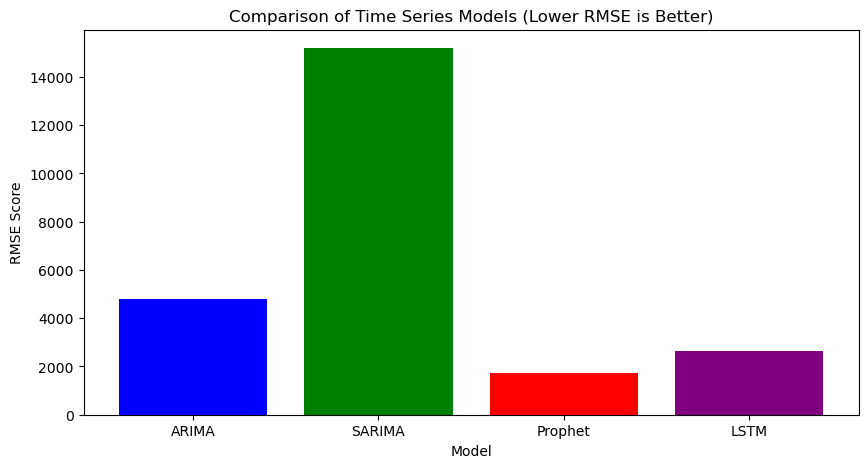


🏆 Best Model: Prophet with RMSE = 1743.03 and MAE = 1334.75


In [19]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Ensure all forecast arrays match the length of test set 
test_size = len(test['AEP_MW'])

forecast = forecast[:test_size]
sarima_forecast = sarima_forecast[:test_size]
prophet_forecast_values = prophet_forecast_values['yhat'][:test_size]  # Extract yhat predictions
lstm_forecast = lstm_forecast[:test_size].flatten()  # Flatten LSTM output

# Calculate errors
models = ['ARIMA', 'SARIMA', 'Prophet', 'LSTM']
mae_scores = [
    mean_absolute_error(test['AEP_MW'], forecast),
    mean_absolute_error(test['AEP_MW'], sarima_forecast),
    mean_absolute_error(test['AEP_MW'], prophet_forecast_values),
    mean_absolute_error(test['AEP_MW'], lstm_forecast)
]

rmse_scores = [
    np.sqrt(mean_squared_error(test['AEP_MW'], forecast)),
    np.sqrt(mean_squared_error(test['AEP_MW'], sarima_forecast)),
    np.sqrt(mean_squared_error(test['AEP_MW'], prophet_forecast_values)),
    np.sqrt(mean_squared_error(test['AEP_MW'], lstm_forecast))
]

# Convert results into a DataFrame for better visualization
results_df = pd.DataFrame({'Model': models, 'MAE': mae_scores, 'RMSE': rmse_scores})
results_df = results_df.sort_values(by='RMSE')

# Print and visualize results
print(results_df)

# Bar Plot for Model Performance
plt.figure(figsize=(10,5))
plt.bar(models, rmse_scores, color=['blue', 'green', 'red', 'purple'])
plt.xlabel('Model')
plt.ylabel('RMSE Score')
plt.title('Comparison of Time Series Models (Lower RMSE is Better)')
plt.show()

# Find the best model based on lowest RMSE
best_model = results_df.iloc[0]
print(f"\n🏆 Best Model: {best_model['Model']} with RMSE = {best_model['RMSE']:.2f} and MAE = {best_model['MAE']:.2f}")


In [25]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, Dense, Flatten, Dropout
from sklearn.preprocessing import MinMaxScaler

# Scaling the data
scaler = MinMaxScaler(feature_range=(0, 1))
train_scaled = scaler.fit_transform(train[['AEP_MW']])
test_scaled = scaler.transform(test[['AEP_MW']])

# Creating sequences for TCN
def create_sequences(data, time_steps=24):
    X, y = [], []
    for i in range(len(data) - time_steps):
        X.append(data[i:i+time_steps])
        y.append(data[i+time_steps])
    return np.array(X), np.array(y)

time_steps = 24
X_train, y_train = create_sequences(train_scaled, time_steps)
X_test, y_test = create_sequences(test_scaled, time_steps)

# Reshape for CNN input
X_train = X_train.reshape(X_train.shape[0], X_train.shape[1], 1)
X_test = X_test.reshape(X_test.shape[0], X_test.shape[1], 1)

# Build TCN model
model_tcn = Sequential([
    Conv1D(filters=64, kernel_size=3, activation='relu', padding='causal', dilation_rate=1, input_shape=(time_steps, 1)),
    Conv1D(filters=64, kernel_size=3, activation='relu', padding='causal', dilation_rate=2),
    Conv1D(filters=64, kernel_size=3, activation='relu', padding='causal', dilation_rate=4),
    Flatten(),
    Dense(50, activation='relu'),
    Dense(1)
])

# Compile and Train
model_tcn.compile(optimizer='adam', loss='mse')
model_tcn.fit(X_train, y_train, epochs=20, batch_size=16, verbose=1)

# Forecasting
tcn_forecast = model_tcn.predict(X_test)
tcn_forecast = scaler.inverse_transform(tcn_forecast)  # Convert back to original scale


Epoch 1/20
6062/6062 [==============================] - 30s 5ms/step - loss: 9.6783e-04
Epoch 2/20
6062/6062 [==============================] - 32s 5ms/step - loss: 5.1855e-04
Epoch 3/20
6062/6062 [==============================] - 32s 5ms/step - loss: 4.4994e-04
Epoch 4/20
6062/6062 [==============================] - 29s 5ms/step - loss: 4.0701e-04
Epoch 5/20
6062/6062 [==============================] - 29s 5ms/step - loss: 3.7467e-04
Epoch 6/20
6062/6062 [==============================] - 31s 5ms/step - loss: 3.5935e-04
Epoch 7/20
6062/6062 [==============================] - 29s 5ms/step - loss: 3.3552e-04
Epoch 8/20
6062/6062 [==============================] - 29s 5ms/step - loss: 3.2374e-04
Epoch 9/20
6062/6062 [==============================] - 30s 5ms/step - loss: 3.1063e-04
Epoch 10/20
6062/6062 [==============================] - 32s 5ms/step - loss: 3.0483e-04
Epoch 11/20
6062/6062 [==============================] - 30s 5ms/step - loss: 2.9668e-04
Epoch 12/20
6062/6062 [=======

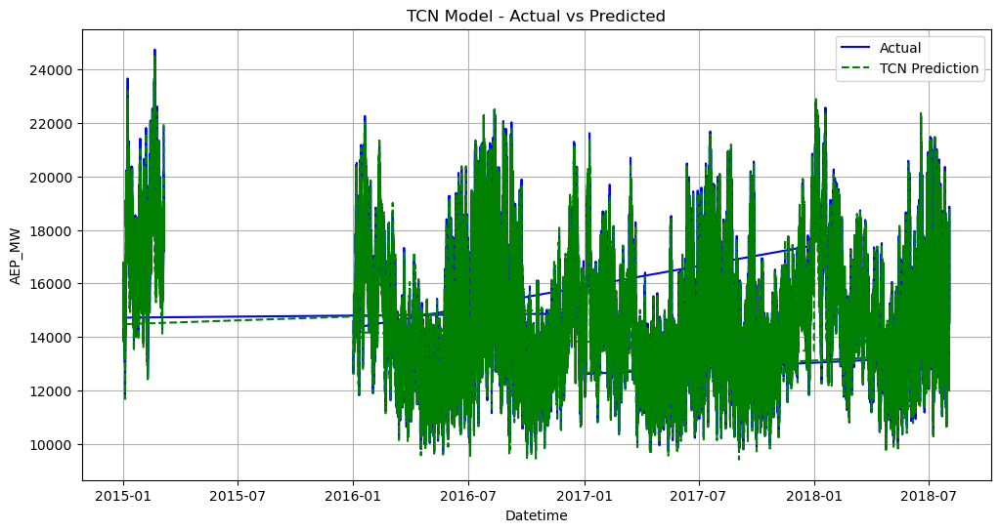

In [26]:
import matplotlib.pyplot as plt

# Create time index for plotting
time_index = test.index[time_steps:]  # Adjusting for sequence length

plt.figure(figsize=(12, 6))
plt.plot(time_index, test['AEP_MW'][time_steps:], label="Actual", color='blue')
plt.plot(time_index, tcn_forecast, label="TCN Prediction", color='green', linestyle="dashed")
plt.xlabel("Datetime")
plt.ylabel("AEP_MW")
plt.title("TCN Model - Actual vs Predicted")
plt.legend()
plt.grid()
plt.show()


In [27]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GRU, Dense
from sklearn.preprocessing import MinMaxScaler

# Scaling the data
scaler = MinMaxScaler(feature_range=(0, 1))
train_scaled = scaler.fit_transform(train[['AEP_MW']])
test_scaled = scaler.transform(test[['AEP_MW']])

# Define time_steps
time_steps = 24  # This determines how many previous time steps to consider

# Function to create sequences
def create_sequences(data, time_steps=24):
    X, y = [], []
    for i in range(len(data) - time_steps):
        X.append(data[i:i+time_steps])
        y.append(data[i+time_steps])
    return np.array(X), np.array(y)

# Prepare data for GRU
X_train, y_train = create_sequences(train_scaled, time_steps)
X_test, y_test = create_sequences(test_scaled, time_steps)

# Reshape to fit GRU input requirements
X_train = X_train.reshape(X_train.shape[0], X_train.shape[1], 1)
X_test = X_test.reshape(X_test.shape[0], X_test.shape[1], 1)

# Build GRU model
model_gru = Sequential([
    GRU(50, return_sequences=True, input_shape=(time_steps, 1)),
    GRU(50, return_sequences=False),
    Dense(25, activation='relu'),
    Dense(1)
])

# Compile and train
model_gru.compile(optimizer='adam', loss='mse')
model_gru.fit(X_train, y_train, epochs=20, batch_size=16, verbose=1)

# Forecasting
gru_forecast = model_gru.predict(X_test)
gru_forecast = scaler.inverse_transform(gru_forecast)  # Convert back to original scale


Epoch 1/20
6062/6062 [==============================] - 77s 12ms/step - loss: 0.0011
Epoch 2/20
6062/6062 [==============================] - 74s 12ms/step - loss: 5.3698e-04
Epoch 3/20
6062/6062 [==============================] - 74s 12ms/step - loss: 4.6421e-04
Epoch 4/20
6062/6062 [==============================] - 77s 13ms/step - loss: 4.1601e-04
Epoch 5/20
6062/6062 [==============================] - 78s 13ms/step - loss: 3.8478e-04
Epoch 6/20
6062/6062 [==============================] - 76s 13ms/step - loss: 3.5718e-04
Epoch 7/20
6062/6062 [==============================] - 76s 13ms/step - loss: 3.3402e-04
Epoch 8/20
6062/6062 [==============================] - 74s 12ms/step - loss: 3.1920e-04
Epoch 9/20
6062/6062 [==============================] - 76s 13ms/step - loss: 3.1181e-04
Epoch 10/20
6062/6062 [==============================] - 77s 13ms/step - loss: 2.9784e-04
Epoch 11/20
6062/6062 [==============================] - 76s 13ms/step - loss: 2.9075e-04
Epoch 12/20
6062/6062 [

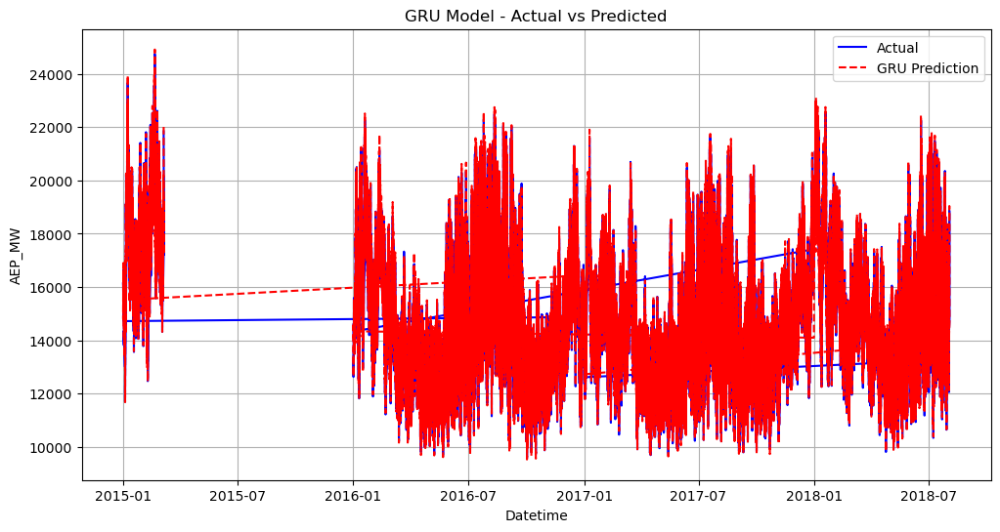

In [28]:
import matplotlib.pyplot as plt

# Create time index for plotting
time_index = test.index[time_steps:]  # Adjusting for sequence length

plt.figure(figsize=(12, 6))
plt.plot(time_index, test['AEP_MW'][time_steps:], label="Actual", color='blue')
plt.plot(time_index, gru_forecast, label="GRU Prediction", color='red', linestyle="dashed")
plt.xlabel("Datetime")
plt.ylabel("AEP_MW")
plt.title("GRU Model - Actual vs Predicted")
plt.legend()
plt.grid()
plt.show()


In [29]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt

mae_gru = mean_absolute_error(y_test, gru_forecast)
rmse_gru = np.sqrt(mean_squared_error(y_test, gru_forecast))

mae_tcn = mean_absolute_error(y_test, tcn_forecast)
rmse_tcn = np.sqrt(mean_squared_error(y_test, tcn_forecast))

print(f"GRU Model: MAE = {mae_gru:.2f}, RMSE = {rmse_gru:.2f}")
print(f"TCN Model: MAE = {mae_tcn:.2f}, RMSE = {rmse_tcn:.2f}")

GRU Model: MAE = 15048.25, RMSE = 15269.37
TCN Model: MAE = 14973.52, RMSE = 15186.83


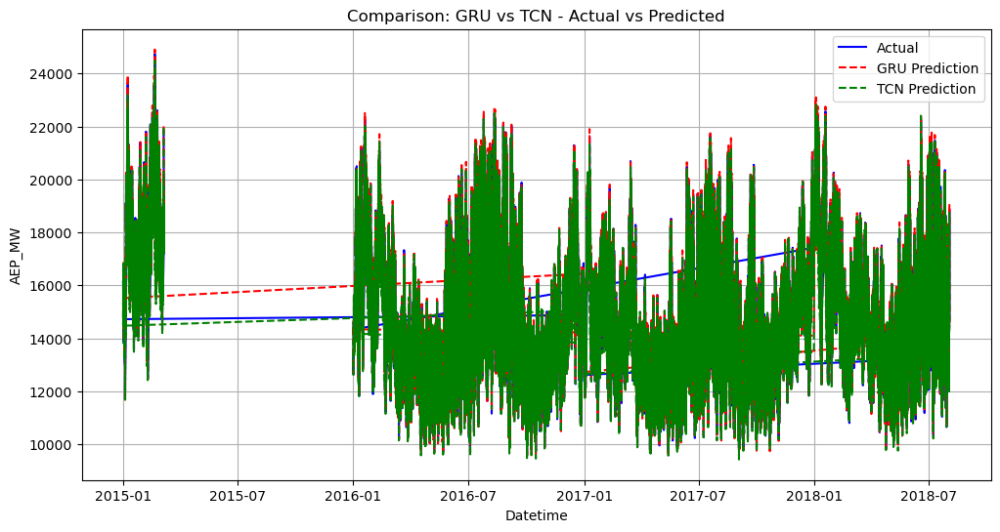

In [30]:
plt.figure(figsize=(12, 6))
plt.plot(time_index, test['AEP_MW'][time_steps:], label="Actual", color='blue')
plt.plot(time_index, gru_forecast, label="GRU Prediction", color='red', linestyle="dashed")
plt.plot(time_index, tcn_forecast, label="TCN Prediction", color='green', linestyle="dashed")
plt.xlabel("Datetime")
plt.ylabel("AEP_MW")
plt.title("Comparison: GRU vs TCN - Actual vs Predicted")
plt.legend()
plt.grid()
plt.show()


In [31]:
import joblib
from prophet import Prophet
import pandas as pd

# Prepare Data for Prophet
prophet_df = df[['AEP_MW']].copy()
prophet_df = prophet_df.reset_index().rename(columns={'Datetime': 'ds', 'AEP_MW': 'y'})

# Train Prophet Model
prophet = Prophet()
prophet.fit(prophet_df)

# Save the trained Prophet model
joblib.dump(prophet, 'prophet_model.pkl')
print("✅ Prophet model saved successfully as 'prophet_model.pkl'")

20:43:03 - cmdstanpy - INFO - Chain [1] start processing
20:45:33 - cmdstanpy - INFO - Chain [1] done processing


✅ Prophet model saved successfully as 'prophet_model.pkl'


In [32]:
import os
print(os.listdir())  

['.bash_history', '.cache', '.conda', '.condarc', '.continuum', '.gitconfig', '.ipynb_checkpoints', '.ipython', '.jupyter', '.keras', '.lesshst', '.matplotlib', '.packettracer', '.VirtualBox', '.VPNMaster', '.vscode', 'Aamir_BU', 'AI', 'anaconda3', 'AppData', 'Application Data', 'Calci.py', 'Cisco Packet Tracer 8.2.1', 'Contacts', 'Cookies', 'Documents', 'Downloads', 'E22CSEU0220_BIG_DATA_LAB_09.ipynb', 'Epoch_Hackathon.ipynb', 'Favorites', 'gensim-data', 'Links', 'Local Settings', 'Microsoft', 'multiple-disease-prediction-98.ipynb', 'Music', 'My Documents', 'NetHood', 'NTUSER.DAT', 'ntuser.dat.LOG1', 'ntuser.dat.LOG2', 'NTUSER.DAT{2ad838bb-efea-11ee-a54d-000d3a94eaa1}.TxR.0.regtrans-ms', 'NTUSER.DAT{2ad838bb-efea-11ee-a54d-000d3a94eaa1}.TxR.1.regtrans-ms', 'NTUSER.DAT{2ad838bb-efea-11ee-a54d-000d3a94eaa1}.TxR.2.regtrans-ms', 'NTUSER.DAT{2ad838bb-efea-11ee-a54d-000d3a94eaa1}.TxR.blf', 'NTUSER.DAT{2ad838bc-efea-11ee-a54d-000d3a94eaa1}.TM.blf', 'NTUSER.DAT{2ad838bc-efea-11ee-a54d-000d3a9

In [34]:
import shutil
shutil.move('prophet_model.pkl', r'C:\Users\aamir\OneDrive\Desktop\Time_Series_Project')

'C:\\Users\\aamir\\OneDrive\\Desktop\\Time_Series_Project\\prophet_model.pkl'